<a href="https://colab.research.google.com/github/marisageyer/ARIWS-Cookbook/blob/main/4-Beamformer/ARIWS_timedomain_tutorial_wget.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#&#128368; $\quad$  **ARIWS Time-domain tutorial**
### June/July 2021 by  Marisa Geyer
    
-------








# &star; &star; &#128269; $\quad$Data detective work $\quad$&star; &star; &star;

It is Thursday afternoon and unanalysed MeerKAT data from a distant source has landed on your desk. 


You roll up your sleeves.

It is time to dig in and find what mysteries it is hiding.

## Step 1: Getting your toolkits ready
Luckily this is not your first day on job. As a seasoned astronomer, you already suspect which tools will be most useful to you. You compile a list of software to load in, and press GO!

**Action 1:** Load the below cells to install the necessary software tools to use on the newly received data

In [7]:
# from https://pypi.org/project/condacolab/
!pip install -q condacolab
import condacolab
condacolab.install()

✨🍰✨ Everything looks OK!


Note: installing psrchive can take a little while **(~3 to 5min)** - you might even be able to make that cup of tea you've been wanting

In [ ]:
%%timeit
import condacolab 
!conda install psrchive

**Action 2:** Import more python libraries by runnning the cell below

In [2]:
import os
import sys
import glob
import random
import subprocess
import pandas as pd
import numpy as np
import seaborn as sns
from datetime import date
sns.set_context('talk')
import psrchive

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

plt.rcParams['figure.figsize'] = (8.0, 8.0)
## The next step randomly chooses a color map from this short list. 
## So the plots could be a different color everytime you plot it. 
## Feel free to add your own favourite color map here!
my_cmap = random.choice(['viridis', 'magma','gist_heat', 'seismic']) 
print(f'Colormap chosen is: {my_cmap:s}')


Colormap chosen is: gist_heat


**Action 3:** And lastly add some small additional tools from GitHub

In [3]:
%%capture
!rm -rf ARIWS_tools
!git clone https://github.com/marisageyer/ARIWS_tools/
tools_dir = '/content/ARIWS_tools/scripts/'
sys.path.insert(0, os.path.abspath(tools_dir))
from tools import *

## Step 2: Download the data

The Astronomer on duty for the week, has copied the unanalysed data an FTP server for you.


**Action 4:** To access the valuable data, you 

1) create a Colab directory "MeerKAT_data" 

2) run *wget* to download the data

3) point the CoLab notebook to the data pathway

4) read in it using psrchive (Finally!)


In [ ]:
!mkdir -p /content/MeerKAT_data

In [ ]:
!wget ftp://elwood.ru.ac.za/pub/mgeyer/ARIWS/meerkat1.ar -P /content/MeerKAT_data

Now point your CoLab notebook to the data's CoLab pathway.

In [ ]:
mydata_dir = '/content/MeerKAT_data'
datafile = 'meerkat1.ar' ## This is the first mystery data you have obtained!

path_to_data = os.path.join(mydata_dir, datafile)
print(path_to_data)

## Step 2b: and read it in!

&star; Now you can and read it in using psrchive!

In [ ]:
data_object = psrchive.Archive_load(path_to_data)
data_object.remove_baseline() 

### &#9758; Note! If you make mistakes down the line with your detective work, 
### then you can come back to **Step 2b** to load the data freshly again. 

## Step 3: Data dimensions

To get a better feel for the data you have, you make notes of the characteristics stored in the **data header**.

A data header contains information about the recorded data, but not the data itself.

**Action 5**: print some of the header information

Notice how the *data_object* which you created above is used to access the header information.

In [ ]:
print(f'The data was captured on {data_object.start_time()} with {data_object.get_telescope()}\n')
print(f'And has the following characteristics:\n')
print(f'Observation duration of \t\t\t {data_object.integration_length():.2f} seconds')
print(f'Number of frequency channels\t\t\t {data_object.get_nchan()}')
print(f'Number of subintegrations (time blocks)\t\t {data_object.get_nsubint()}')
print(f'Each subintegration (time block) is made up of   {data_object.get_nbin()} data bins')

**Q1:** Using the above information how much **observing time (seconds)** is associated with each subintegration (or time block)?

In [ ]:
time_per_subint = ## add your computation here. 
print(f'{time_per_subint} seconds')

## Step 4: The observing band
These days MeerKAT boasts two operational receivers on every antenna, each with their own observing frequencies. 

Better check, which observing band was used for the observation you are analysing. 

**Action 6:** You decide the quickest way is to see what frequencies (in MHz) are associated data you have loaded, and find

In [ ]:
freqs = data_object.get_frequencies()
print(f'{freqs[0]:.2f} to {freqs[-1]:.2f} in MHz')

**Q2**: Which observing band is this? U-band or L-band?

In [ ]:
## Add your answer here

## Step 5: A first plot

Now that you know the dimensions of your data, you decide it's best to have a visual look at it.

If you add all the data in time - the signal will be the brightest. 

*psrchive* has a list of "scrunch" commands to add the data_object in different dimensions:

- fscrunch()
- tscrunch()
- bscrunch()

**Q3**: Which *psrchive* scrunch command do you think would add (integrate) the data in **time**?



In [ ]:
## Add your guess here

You can check if you have used the correct scrunch command, by double checking that the number of subintegrations (time blocks) after you have applied it is **equal to one**. 

**If not**, you've probably used the wrong scrunch command, and it's best to load the data newly by running from Step 2!


In [ ]:
data_object. ## add your scrunching command here to add the data in time. The command should end with open brackets, just like the commands in Step 3.

## You can check if you have used the correct scrunch command, by double checking that the subintegration (time blocks) is now equal to one. 
## If not! You've probably used the wrong scrunch command, and it's best to load the data newly by running from Step 2!

print(f'Your data now has {data_object.get_nsubint():d} subintegration (time blocks) with {data_object.get_nbin():d} data bins')

data = data_object.get_data() ## This command retrieves the data as a numpy array from the data_object (As you've seen the data_object contains more than just the data itself, e.g. the header information in Step 3)
print(np.shape(data))
data = data.reshape(len(freqs),data_object.get_nbin()) ## This gets rid of those extra dimensions in the above shape that only has one column
print(np.shape(data)) ## Now the data is a two-dimensional array with frequency channels, and time bins (a single time block from adding all the data, made up of 1024 data points)

## Let's plot the data
plt.imshow(data, aspect='auto', cmap=my_cmap, origin='lower')
labely = plt.ylabel("Frequency channels")
labelx = plt.xlabel("Time bins")

Double check the number of time blocks,

In [ ]:
print(f'Your data now has {data_object.get_nsubint():d} subintegration (time blocks) with {data_object.get_nbin():d} data bins')

**Q4:** Does your data now have only **one** subintegration (time block)? 

If not start again from Step 2. 

## Step 6: Who goes there?

You're not so sure about this data! That looks a bit suspicious. 
Maybe even a bit **man made**!

Time to zoom in on those scruffy channels and see where exactly they lie. 


**Action 8:** Zoom in on the strange channels in the above plot by picking y-axis limits. 

This will help you identify which channels numbers exactly look contaminated. 



In [ ]:
## Pick a window of channel numbers to zoom into
zoom_in_lower =  ## with this as the lower limit 
zoom_in_upper =  ## and this as the upper

plt.imshow(data, aspect='auto', cmap=my_cmap, origin='lower')
plt.ylim(zoom_in_lower, zoom_in_upper)
labely = plt.ylabel("Frequency channels")
labelx = plt.xlabel("Time bins")

**Q5**: Which channel numbers do you think contain the artificial signals?

In [ ]:
## add your answer here

## Step 7: removing Radio Frequency Interference (RFI)

Ok, now that you know which are the contaminated channels, it is time to remove them. 

**Action 9:** Choose the range of frequency channels that you want to delete (set to zero) because you think they contain Radio Frequency Interference (RFI) and not astronomical signals


In [ ]:
## Pick the channels to get rid of
RFI_channel_start = ## first channel to remove
RFI_channel_end = ## and remove up to this channel number

## Zero the values in "data" from channel_start to channel_end:
data[RFI_channel_start:RFI_channel_end,:] = 0

In [ ]:
## Plot the signal after having zeroed the RFI frequency channels
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(25,7))
ax1.set_title("Datablock after having removed frequency channels %d to %d" %(RFI_channel_start, RFI_channel_end))
ax1.imshow(data, aspect='auto', cmap=my_cmap, origin='lower')
labely = ax1.set_ylabel("Frequency channel number")
labelx = ax1.set_xlabel("Time bins")

ax2.set_title("Zoom in: datablock after having removed frequency channels %d to %d" %(RFI_channel_start, RFI_channel_end))
ax2.imshow(data, aspect='auto', cmap=my_cmap, origin='lower')
ax2.set_ylim(zoom_in_lower, zoom_in_upper)
labely = ax2.set_ylabel("Frequency channel number")
labelx = ax2.set_xlabel("Time bins")

Now some other signals have popped out! Can you believe that was hiding behind the contaminated data. 

Not bad, detective!

If you see more RFI you can remove even more frequency channels to get a further increase in brightness of the astrophysical signal.

In [ ]:
## Zero some more channels containing interference

## Pick a window of channel numbers to zoom into to better identify channel numbers you want to remove
zoom_in_lower =  ## with this as the lower limit 
zoom_in_upper =  ## and this as the upper

plt.imshow(data, aspect='auto', cmap=my_cmap, origin='lower')
plt.ylim(zoom_in_lower, zoom_in_upper)

In [ ]:
## Now zero another set of channels containing RFI
RFI_channel_start2 = ## add the channel number of the start of the affected region here 
RFI_channel_end2= ## and the channel number of the end of the affected region 
data[RFI_channel_start2:RFI_channel_end2] = 0
## Then rerun the plot in Step 7

## Step 8: Labelling axes
### But why is the signal banded? It looks like it is smeared across frequencies? Something to ponder!

Since you are happy that you have removed the interference, you decide to make a first proper plot.

With frequency labelling in **MHz** rather than channel numbers.

Luckily you've already created 'freqs' (in Step 4) which contains the frequencies in MHz for each channel. 

**Action 10:** See if you can change the extent of the plot to go from the first frequency channel to the last. 

For now you'll leave the time bins to go from 0 to 1024 (arbitrary units). 

In [ ]:
timestart = 0
timeend = data_object.get_nbin()
lowestfreq = ## fill in the lowest frequency channel in MHz here (using the array 'freqs')
highestfreq = ## fill in the highest frequency channel in MHz here (using the array 'freqs')

plt.figure(figsize=(8,16))
plt.imshow(data, extent=(timestart,timeend,lowestfreq, highestfreq), aspect='auto', cmap=my_cmap, origin='lower')
plt.grid(color='w', ls='dashed') ## adding white grid lines to the plot
plt.ylabel("Frequency (MHz)")
plt.xlabel("Time bins (arbitrary unit)")

Looking at a single smeared signal, you see it appears to 

**arrive at a higher frequency first (time=0), and is then travels to a lower frequency in time ...**

this rings a bell!

**Action 11:** Again, you zoom in to look more closely at a smaller part of the figure. 

Let's look only at a 20 MHz range.

In [ ]:
## Pick a 20 MHz frequency range to zoom into, by picking a lower and upper limit
ylim_low = 
ylim_high = 

plt.figure(figsize=(8,8))
plt.imshow(data, extent=(0,timeend,freqs[0], freqs[-1]), aspect='auto', cmap=my_cmap, origin='lower')
plt.ylabel("Frequency (MHz)")
plt.xlabel("Time (arbitrary unit)")
plt.ylim(ylim_low,ylim_high) ## this is where your limit are used

## Step 9: Of course it's a ......



**Q6:** What is causing the smear across frequency?

**Q7:** And why is the signal wrapping?

**Q8:** What astrophysical object has MeerKAT been looking at?

In [ ]:
## add your answers here
## Q6:
## Q7:
## Q8:

## &#9742; Ring ring ...

#### You decide to ring your fellow astronomer, Marisa,  with the news. She'll been keen to hear about this data!

#### And maybe will have some ideas about where to go next.  

In [ ]:
## DISCUSSION with Marisa reveals
## (Remove:) Aha, now that you know it is a pulsar, you can see that the data has already been folded on the pulse period of the pulsar making the siganl wrap around.

## (Remove:) So if you know how much time in seconds each time bin represents you can compute the pulseperiod.

## (Remove:) Luckily, this is written into the metadata of the datafile so you check:

**Action 12:** Following her advice let's have a look at time resolution of the data you are looking at. 

This will tell you how much time is associated with each time bin of the data.

This is another piece of information that lives in the **data header** of data_object.

In [ ]:
time_resolution = time_per_bin(data_object)

print(f'Each bin within the time block which has {data_object.get_nbin():d} bins represents {time_resolution:.8f} seconds')
print(f'Wow, the telescope is performing!')
print(f'Capturing data every {time_resolution:.8f} seconds or {time_resolution*1e6:.2f} microseconds')

## Step 10: Calculating the pulse period
You are really zoning in on this mystery now! 

Once you know the pulsar period you are well on your way to figuring out which source this is!

**Action 13:** Compute the period of this periodic source, based on your knowledge of the time associated with each time bin (the time resolution) and the number of time data bins. 


In [ ]:
period = ## compute the pulse period here
ms_period = ## transform the pulse period in seconds to miliseconds

print(f'The pulsar has a rotational period of {period:.5f} seconds')
print(f'or {ms_period:.3f} miliseconds')

##Step 10b: Labelling axes again.
### Alright now you can also redo the plot of Step 8 and change the x-axis to **pulse period in seconds**, or to a single pulse rotation from pulse phase 0 to 1

In [ ]:
timestart = 0
time_stop = period 

fig, ax = plt.subplots(figsize=(8,16))
ax.imshow(data, extent=(timestart,time_stop,lowestfreq, highestfreq), aspect='auto', cmap=my_cmap, origin='lower')
ax.grid(color='w', ls='dashed') ## adding white grid lines to the plot
ax.set_ylabel("Frequency (MHz)")
ax.set_xlabel("Time (seconds)")
ax1 = ax.twiny()
ax1.set_xlabel("Pulse rotation (phase)")

## Step 11: Look up the source 

A list of known pulsars can be found in the *Australia Telescope National Facility's* (ATNF) pulsar catalogue here:

https://www.atnf.csiro.au/research/pulsar/psrcat/

To find a source with a pulse period (P0) close to the computed pulse period, you can use the *condition* and filter for 


"p0 < p_large p1 & p0 > p_small"


such that the pulse period of the pulsar in your data (p0) lies between p_small and p_large

If you struggle to use the website you can find a list of pulsars with pulse periods
+ larger than 0.02 seconds 
+ and smaller than 0.025 seconds 

[right here](https://www.atnf.csiro.au/research/pulsar/psrcat/proc_form.php?version=1.64&Name=Name&P0=P0&startUserDefined=true&c1_val=&c2_val=&c3_val=&c4_val=&sort_attr=P0&sort_order=asc&condition=p0+%3E+0.02+%26%26+p0+%3C+0.025&pulsar_names=&ephemeris=short&coords_unit=raj%2Fdecj&radius=&coords_1=&coords_2=&style=Long+with+last+digit+error&no_value=*&fsize=3&x_axis=&x_scale=linear&y_axis=&y_scale=linear&state=query&table_bottom.x=25&table_bottom.y=19).



**Q9:** which pulsar's data do you think you are looking at?

In [ ]:
## Q9: answer here

## Step 12: Estimate the disperison measure

To align the pulsar signal, you know you have to get rid of this smearing effect.

For which, paging through your notebook, you have to compute the dispersion measure - which relates the amount of frequency smear for a given time


The delay, $\Delta t$, in seconds, between the arrival times of pulses at frequencies, $\nu_{lo}$ and $\nu_{hi}$ is given by

\begin{equation}
\Delta t = 4.149\times10^3 \biggl(\rm{DM}\biggr) \biggl[\frac{1}{\nu_{lo}^{2}}-\frac{1}{\nu_{hi}^{2}}\biggr]
\end{equation}

where $\nu_{lo}$ and $\nu_{hi}$ are in MHz, 

or 

\begin{equation}
\rm{DM} = \frac{\Delta t}{4.149\times10^3} \frac{\nu_{lo}^{2} \nu_{hi}^{2}}{\nu_{hi}^{2}-\nu_{low}^{2}}
\end{equation}


So if you can estimate the characteristic smearing, or dispersion measure (DM), then you can properly align the pulsar signal.

 

**Action 13:** Looking back at your zoomed-in figure of the frequency smear (Action 11), estimate a high frequency where the signal starts and a low frequency value where the signal ends, while using the pulse period as the delay between these frequencies.

In [ ]:
## Pick the frequency range of a single smeared siganl 
freq_hi = ## pick the start of a smeared signal here (in MHz)
freq_low = ## and the end of the smeared signal here (in MHz)

DM_const = 4149  ## This is known as the dispersion measure constant and has the value 4149 MHz^2 pc^−1 cm^3 s, as you can see in the above calculation
DM = period/DM_const*(freq_hi**2*freq_low**2)/(freq_hi**2 - freq_low**2)
print(f'DM={DM:.2f}')

## Step 13: Correct the dispersion
Now let's correct the dispersion for each channel by using the computed DM value.

You bring up an old schematic you have to remind you how the dedispersion process works. 

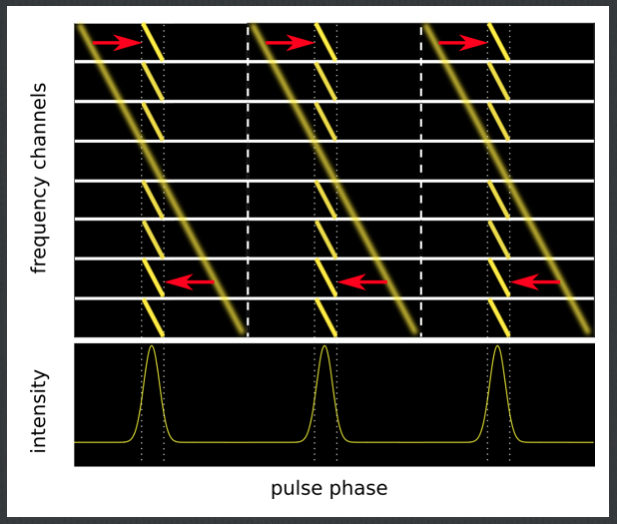

In [ ]:
img='/content/ARIWS_tools/scripts/dedispersion.png'
from IPython.core.display import Image, display
display(Image(img, width=600, unconfined=True))

Luckily, you have a function that you've written before which computes the required shift for each frequency channel in seconds. 

**Action 14:** Since your data is an indexed numpy array here, you just have to write that shift in seconds into a shift of data bins.

In [ ]:
def rotate_array(arr, nbins):
    return [arr[(nbins + i) % len(arr)] for i in range(len(arr))]


def correct_dispersion(data, freqs,DM, period, printout=True):
    print(f'Correcting dispersion using a DM value of {DM:.4f} pc cm$^{-3}$')
    print(f'---------------------------------------------------------------')
    nchan, nbin = np.shape(data)
    nchan, nbin = np.shape(data)
    DMcorr_data=np.zeros((nchan,nbin),dtype=float)

    center_freq=np.median(freqs)

    for chan in range(nchan):
 
        data_chan = data[chan]
        freq_chan = freqs[chan]
        if printout==True:
          print(f'To correct the dispersion of frequency channel {chan:d} ({freq_chan:.2f} MHz), ',end='')
        shift_sec = DM_const*DM*(1/freq_chan**2 - 1/center_freq**2)

        #shift_bins = int() ## add your computation for the shift in bins here. In other words transform the shift in seconds (shift_sec) to a shift in bins. 
                      ## remember bins should be an integer, so after transforming from seconds to bins use int() 

        shift_bins_mod = np.mod(shift_bins,1024) 
        if printout==True:
          print(f'we shift the data by {1000*shift_sec:.2f} ms or {shift_bins_mod:d} bins')

        # rotate the data by the number of bins
        data_shifted=rotate_array(data_chan,shift_bins_mod)

        DMcorr_data[chan,:]=data_shifted
    
    return DMcorr_data

**Action 15:** Run the function to correct dispersion using your computed DM value. 

In [ ]:
DMcorr_data=correct_dispersion(data,freqs,DM,period)

**Action 16:** Let's see how well that worked by plotting the corrected signal.

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(DMcorr_data, extent=(0,period,freqs[0], freqs[-1]), aspect='auto', cmap=my_cmap, origin='lower')
plt.ylabel("Frequency (MHz)")
plt.xlabel("Time (sec)")
plt.grid()

## Step 13b: Fine tune the Dispersion Measure (DM)

You know that if you computed the dispersion measure correctly the signal should now align across frequencies, producing **vertical** pulses.

**Action 17:** Tinker with the DM value in correct_dispersion() above until you are happy that the pulsar signal is fully de-dispersed!

*Hint:* Only make small changes (< 2.0) at a time.

In [ ]:
DM =  ### use a value slighlty higher or lower than your first estimated DM (from Action 13) here to help fine-tune its value
DMcorr_data=correct_dispersion(data,freqs,DM,period,printout=False)  ## Setting printout to "False" surpresses all the print statements from before for a cleaner screen.

fig,ax=plt.subplots(figsize=(10,10))

#plot the corrected data
ax.imshow(DMcorr_data, extent=(0,period,freqs[0], freqs[-1]), aspect='auto', cmap=my_cmap, origin='lower')
ax.set_ylabel("Frequency (MHz)")
ax.set_xlabel("Time (ms)")


# Add more detailed gridlines to help you see if it is straight!
ax.xaxis.set_minor_locator(ticker.MultipleLocator(0.001))
ax.yaxis.set_minor_locator(ticker.MultipleLocator(50))
ax.grid(which='minor', ls='dashed', alpha=0.8,color='w')
ax.grid(which='major', axis='both', linestyle='-')

## Step 14: Finally, the added pulse profile!

**Action 18**: Adding all the frequency channels after the dispersion is corrected, gives you the integrated stable pulsar profile

In [ ]:
## average_profile = np.sum() ### sum the DM corrected array here

plt.figure(figsize=(10,5))
plt.title("Dispersion corrected profile")
plt.plot(np.linspace(0,1,1024), average_profile)
plt.show()

plt.figure(figsize=(10,5))
print(f'\nGood thing we did the dedispersion, without it the signal would look much worse:\n')
plt.title("No dispersion correction")
plt.plot(np.linspace(0,1,1024), np.sum(data, axis=0))
xlab=plt.xlabel("Pulse rotation (phase)")

### What an interesting pulse shape - we see two peaks! 
### This must mean we are seeing both the North pole and South pole of this pulsar.

**Q10:** Can you see the pulse shape without dispersion correction?

## Step 15: Compute the signal to noise (S/N) for this pulsar observation
The S/N is the ratio between the *pulse signal* and the *noise level*:
+ we can characterise the signal as the peak of the pulse profile
+ and the noise level as the standard deviation of the noise floor, or the off-pulse region

**Action 19:** Compute the S/N of your averaged pulse profile shape

In [ ]:
plt.figure(figsize=(8,5))
plt.plot(average_profile)
xlab=plt.xlabel("Time bins")

## Pick an off-pulse region which represents the noise floor of the observation and compute its standard deviation
off_pulse_start =  
off_pulse_end =  

noise_std = np.std(average_profile[off_pulse_start:off_pulse_end])

## Compute the maximum peak height of the pulsar as a measure of its brightness
peak = np.max()

plt.axhline(y=peak,ls='dotted', color='g', label='peak') ## this shows the peak you have computed
plt.axvline(x=off_pulse_start,ls='dotted', color='r') ## these show the off-pulse region you have selected
plt.axvline(x=off_pulse_end,ls='dotted', color='r')

## Compute the signal-to-noise ratio using these values you have computed
snr = 
print(f'S/N: {snr:.4f}')

What an interesting pulse shape - we see two peaks! This must mean we are seeing both the North pole and South pole of this pulsar.



## Step 16: Summarise 

Time for this detective to summarise what's been learned from the data so far. 


In [ ]:
## Firstly this is data of a pulsar, 
## At the MeerKAT band
val_band =
## and you think the source name is
val_pulsarname =
## It has a pulse period of 
val_pulseperiod = ms_period ## in ms
## The source has a DM value of
val_DM =
## And a S/N value 
val_snr = 
## After an observation of length
val_obslength = data_object.integration_length()


print(f'Summary for MeerKAT data {val_band} data analysed on {date.today()}: \n')
print(f'Pulsar: \t PSR {val_pulsarname}\n')
print(f'Pulse period: \t {val_pulseperiod:.5f} ms \n')
print(f'DM value: \t {val_DM:.4f} pc cm-3\n')
print(f'S/N value: \t {val_snr:.2f}\n')
print(f'Obs duration: \t {val_obslength:.2f} seconds\n')

### Ok, so the averaged high S/N pulse profile is what you obtained after having added the observing time together, as well as all the frequency channels, and correcting for the dispersion.

# &#128161; but since pulsars are interesting clocks ... you think it might be worth checking how the pulsar behaves with time

## Step 17: Let's see this clock tick -- **load in time resolved data**
To observe what is happening with the pulse signal you will need to load the data newly, since previously you added the timeblocks together using tscrunch()

So back to loading in the original data ...


In [ ]:
data_object2 = psrchive.Archive_load(path_to_data)
data_object2.remove_baseline()

## You rerun some of the commands you used in Step 4, to remind yourself of the data dimensions
print(f'And has the following characteristics:')
print(f'Number of frequency channels\t\t\t {data_object2.get_nchan()}')
print(f'Number of subintegrations (time blocks)\t\t {data_object2.get_nsubint()}')
print(f'Each subintegration (time block) is made up of \t {data_object2.get_nbin()} data bins')

time_per_subint = data_object2.integration_length()/data_object2.get_nsubint()
print(f'Time of each subintegration: \t\t\t {time_per_subint:.2f} seconds')

**Action 20:** Compute how many pulse rotations are contained in every subintegration (using your previously computed pulse period).



In [ ]:
number_pulses_per_subint = 
print(number_pulses_per_subint)

This time you will add all the frequency channels together from the start, and just study how the pulsar changes with time

You do so with the **fscrunch()** command

In [ ]:
data_object2.dedisperse()
data_object2.fscrunch()
data_time = data_object2.get_data().reshape(data_object2.get_nsubint(),data_object2.get_nbin())
print(np.shape(data_time)) ## the only dimensions of the data now are the number of time blocks (subintegrations) and phase bins

## Step 18: Watch the timeseries as a movie to see how the pulsar behaves with time


In [ ]:
%%capture
# Set up the figure canvas for the movie
fig,ax = plt.subplots(1, figsize=(12,5))
title = ax.text(0.45,0.85, "", bbox={'facecolor':'w', 'alpha':0.5, 'pad':5},
                transform=ax.transAxes, ha="center")
ph, = ax.plot(data_time[130])
txt = ax.text(100, 0.004, "Max peak value",color='r')
#ax.axis('off')
ax.set_ylim(-0.001, 0.01)

**Action 21:** Run the animation. Note that it will take some time to load **(~ 3min)**

In [ ]:
# function for drawing each frame
def singleframe(i):
  ph.set_ydata(data_time[i])
  ph.set_xdata(np.linspace(0,1024,1024))

  title.set_text(u" Time block = {}, Max. value = {:.4f}".format(i, np.max(data_time[i])))
  xx = np.linspace(0,1024,len(data_time))
  max_points = [np.max(data_time[i]),np.max(data_time[i-1])] 
  maxtrend = ax.plot([xx[i], xx[i-1]], max_points, 'r-o', markersize=4,alpha=0.6)                                    
  return ph, title, maxtrend
  
# create the animation
ani=animation.FuncAnimation(fig, singleframe, range(5, len(data_time)))
ani

**Q11:** Do you see any changes in the pulse profile with time?

**Q12:** If so, when do the changes appear? 

**Q13:** And how long do they last?

**Action**: Let's also make a 2D plot of how the pulse shape changes.
We'll use the observing time to change the axis from time blocks (subintegrations) to observing time (seconds)

In [ ]:
##The full observing time of the data is given by, 
obstime = data_object2.integration_length()
print(f'The full observing time is {obstime:.2f} seconds')
obs_start = 0
obs_end = obstime

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(data_time,extent=(0,1,obs_start, obs_end), aspect='auto', cmap='magma', origin='lower')
plt.ylabel("Time (sec)")
plt.xlabel("Pulse phase")
plt.grid()

**Q14:** What do you see when plotting the pulse intensity as a function of time in this 2D plot? Does it agree with what you observed in the animation?

**Action** Estimate the duration for which the pulsar appears to dim (in seconds) using either the animation or the 2D plot output

In [ ]:
dimming_duration = ## in seconds

## &star; &star; &star; You've got to know more about this odd dimming of the pulsar! &star; &star;

### You know that MeerKAT can record at even higher time rates than the data you have. 

### Time to ring the operator on duty. 


# &#9742; Ring ring ...

### If she can observe pulsar J0737-0737 for you at a higher recording rate, than maybe you can learn more about what is going on in the gap ...  almost like Jocelyn Bell-Burnell running her penchart recorder at higher speeds :)

### The operator on duty picks up: you provide her with the pulsar name and your dispersion measure to set the coherent dedispersion back-end. 




## Step 19: The **high time resolution** data is here! 

Now that you already know most of the process it will be easily to check out. 
Load in the data and rerun some of the commands you used in Step 4 to investigate the data dimensions

Time to download it using *wget* as before

In [ ]:
!wget ftp://elwood.ru.ac.za/pub/mgeyer/ARIWS/meerkat2_highres.ar -P /content/MeerKAT_data

In [ ]:
print(mydata_dir)

In [ ]:
datafile3 = 'meerkat2_highres.ar'

path_to_data = os.path.join(mydata_dir, datafile3)
print(path_to_data)
data_object3 = psrchive.Archive_load(path_to_data)

data_object3.remove_baseline()

## You rerun some of the commands you used in Step 4, to remind yourself of the data dimensions
print(f'And has the following characteristics:')
print(f'Number of frequency channels\t\t\t {data_object3.get_nchan()}')
print(f'Number of subintegrations (time blocks)\t\t {data_object3.get_nsubint()}')
print(f'Duration of the observation\t\t\t {data_object3.integration_length():.2f} seconds')

time_per_subint = data_object3.integration_length()/data_object3.get_nsubint()
print(f'Time of each subintegration \t\t\t {time_per_subint:.2f} seconds')

**Q14:** How does this time per block or subintegration compare to the lower time resolution data you had previously?

In [ ]:
## answer here

In [ ]:
data3 = data_object3.get_data().reshape(data_object3.get_nsubint(),data_object3.get_nbin())

In [ ]:
##The full observing time of these data are given by, 
obstime_highresdata = data_object3.integration_length()
print(f'The full observing time is {obstime_highresdata:.2f} seconds. So a much shorter observation than the previous one. Just zooming in on that part where the pulsar light dims.')

## Step 20: Plot the **high time resolution** data

Investigate the high time resolution data, again using a 2D plot of pulse period or pulse phase on the x-axis and observing time on the y-axis.

In [ ]:
obs_start= 0 ## add observation starting time in seconds
obs_end= obstime_highresdata## and an obsservation ending time in seconds (similar to the second plot of Step 18) 

plt.figure(figsize=(8,8))
plt.imshow(data3,aspect='auto', extent=(0,1, obs_start,  obs_end), cmap=my_cmap, origin='lower')
plt.ylabel("Observing time (sec)")
plt.xlabel("Pulse phase")

## &#129427;  ...     Zebra-stripes in the gap where the pulsar light dims!
## What could that mean?
### By plotting the data added across the pulse, you can see the ossicilations more clearly. 


In [ ]:
fig, ax = plt.subplots(2,1,figsize=(24,8))
fig.subplots_adjust(hspace=0.5)

ax[0].set_title("The cumulative change in pulse intensity as a function of observing time")
ax[0].plot(np.linspace(0,obstime_highresdata,data_object3.get_nsubint()),np.sum(data3[:,320:420], axis=1))
ax[0].set_xlabel("Observing time (seconds)")

ax[1].set_title("Zoom in to see the spacings between the fluctuations")
ax[1].plot(np.linspace(0,obstime_highresdata,data_object3.get_nsubint()),np.sum(data3[:,320:420], axis=1))
ax[1].set_xlim(40,70)
ax[1].set_xlabel("Observing time (seconds)")


# Add more detailed gridlines to help you see if it is straight!
ax[1].xaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax[1].xaxis.set_major_locator(ticker.MultipleLocator(2))

ax[1].grid(which='major', axis='both', alpha=0.6,color='k', ls='solid')
ax[1].grid(which='minor', axis='x', alpha=0.4,color='k', ls='dashed')

## Step 21: The period of these new peaks

### The zoomed in plot you've made above shows how during that dimming episode of the pulsar, the intensity of the observed pulsar light is fluctuation.

**Action:** Compute the time between peaks in the osscillations during the dimming of the pulsar

In [ ]:
peak1 = ## choose a time at which one peak occurs
peak2 = ## and when the next peak occurs
time_between_peaks = ## use peak1 and peak2 to compute the time between peaks in seconds

##&#128269; $\quad$ The status of your detective notes, 

In [ ]:
print(f'During a MeerKAT observation of {val_band} data of PSR {val_pulsarname},\n')
print(f'which has a pulse period of {val_pulseperiod:.2f} ms, \n')
print(f'the pulsar light appeared to dim for about {dimming_duration} seconds. \n')
print(f'You requested higher time resolution data to see what exactly is going on during that dimming episode ... \n')
print(f'And found another periodic signal within the gap with a period of around {time_between_peaks} seconds! \n')

print('What a crazy system!\n')
print('What could be going on?')

## Step 22: Time to play hangman to help you understand!

In [4]:
hangman()

What is your name? j



Hello, j time to play hangman!



What do you think is causing the pulsar light to dim?


Start guessing...


_ _ _ _ _ _ _ 

guess a character: eclipse


e c l i p s e 


That's right! The pulsar's light is dipping because of a companion passing in front of it.

As you can see in this animation ... wait for it ...



And the companion is another pulsar!





But to learn where these Zebra stripes come from you have to look at the details of the pulsar's magnetosphere.

The magnetosphere is the plasma trapped in the closed magnetic field lines of the pulsar, and can be modelled as a doughnut-shape.

This animation shows you what is going on ...


The movie can also be found at http://www.jb.man.ac.uk/~bretonr/doublepulsar/movies/doublepulsar_eclipse.mov
